In [4]:
import torch
import sys
import scanpy as sc
import os
sys.path.append(os.path.abspath("FRLC"))
import FRLC
import FRLC_multimarginal
import importlib
import HiddenMarkovOT
import util_LR
from util_LR import convert_adata
import pandas as pd
import objective_grad
import clustering
import HiddenMarkovOT
import plotting
import pickle
import numpy as np

idxs = [1]

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Filehandle for final differentiation map outputs
diffmap_dir = "/scratch/gpfs/ph3641/hm_ot/ME_supervised_diffmap/"
os.makedirs(diffmap_dir, exist_ok=True)

# Cell-type labels for all timepoints + replicates
df_cell = pd.read_csv("/scratch/gpfs/ph3641/hm_ot/df_cell.csv")
df_cell = df_cell.set_index("cell_id")

timepoints_across_datasets =  [['E8.5', 'E8.75']]
replicates_across_datasets = [['embryo_11', 'embryo_14']]


In [6]:
importlib.reload(util_LR)
importlib.reload(HiddenMarkovOT)
importlib.reload(FRLC)

for i in range(len(timepoints_across_datasets)):
    """
    Loading file / AnnData
    """
    filehandle_ME = f'/scratch/gpfs/ph3641/hm_ot/adata_JAX_dataset_{idxs[i]}.h5ad'
    sys.path.insert(0, filehandle_ME)
    adata = sc.read_h5ad(filehandle_ME, backed="r")
    
    timepoints = timepoints_across_datasets[i]
    replicates = replicates_across_datasets[i]

    for tp in range(len(timepoints)-1):
        """
        Iterating across all timepoint pairs, stitching separate AnnDatas together when necessary.
        """
        if (tp+1) < len(timepoints):
            # Aligning two timepoints within a dataset.
            t1 = timepoints[tp]
            t2 = timepoints[tp+1]

            r1 = replicates[tp]
            r2 = replicates[tp+1]
            
            print(f'Aligning timepoint {t1} to {t2}')
            
            # Generate a pairwise subset of the dataset
            subset_adata = adata[
                    (adata.obs['day'].isin(timepoints[tp:tp+2])) & 
                    (adata.obs['embryo_id'].isin(replicates[tp:tp+2]))
            ]
        
        """
        Now, (1) integrate cell-type labels and (2) perform HM-OT on the one-hot encoded labels.
        """
        subset_adata = subset_adata.to_memory()
        
        subset_adata.obs = subset_adata.obs.set_index("cell_id")
        subset_adata.obs = subset_adata.obs.join(df_cell[['celltype_update']], how="left")

        print(f'Adata1: ')
        print(subset_adata[subset_adata.obs['day'] == t1])
        print(f'Adata2: ')
        print(subset_adata[subset_adata.obs['day'] == t2])
        
        print('-----Starting PCA!-----')
        
        sc.pp.normalize_total(subset_adata, target_sum=1e4)  # Normalize per cell
        sc.pp.log1p(subset_adata)
        sc.pp.pca(subset_adata, n_comps=30)

        print('-----PCA done!-----')
        
        tps = [t1, t2]
        rps = [r1, r2]

        """ Compute ranks """
        rank1 = subset_adata[subset_adata.obs['day'] == t1].obs['celltype_update'].nunique()
        rank2 = subset_adata[subset_adata.obs['day'] == t2].obs['celltype_update'].nunique()
        print(f'Rank 1:{rank1} to Rank 2:{rank2}')

        """
        Set distance matrix rank; if number of cell-types less than 100 then set to 100,
            otherwise default to smallest number of cell-types
        """
        r_max = max( min(rank1, rank2), 100)
        

Aligning timepoint E8.5 to E8.75
Adata1: 
View of AnnData object with n_obs × n_vars = 20150 × 24552
    obs: 'keep', 'day', 'embryo_id', 'experimental_batch', 'celltype_update'
    var: 'gene_id', 'gene_type', 'gene_short_name', 'chr'
Adata2: 
View of AnnData object with n_obs × n_vars = 33383 × 24552
    obs: 'keep', 'day', 'embryo_id', 'experimental_batch', 'celltype_update'
    var: 'gene_id', 'gene_type', 'gene_short_name', 'chr'
-----Starting PCA!-----
-----PCA done!-----
Rank 1:46 to Rank 2:55


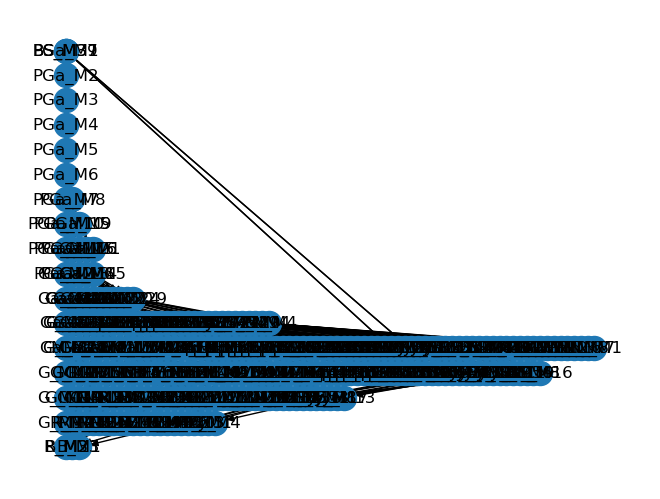

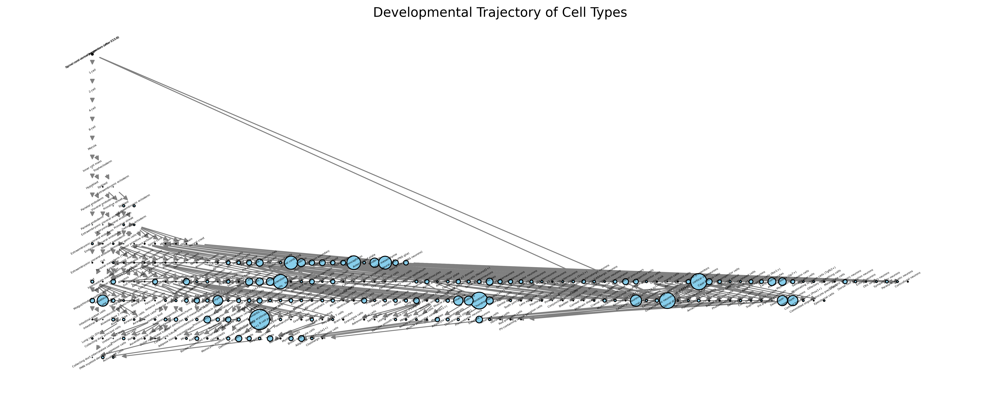

In [7]:
from collections import defaultdict
import networkx as nx
import matplotlib.pyplot as plt

edge_dir = "/scratch/gpfs/ph3641/hm_ot/edges.txt"
node_dir = "/scratch/gpfs/ph3641/hm_ot/nodes.txt"


# Load the data
nodes_df = pd.read_csv(node_dir, sep="\t")
edges_df = pd.read_csv(edge_dir, sep="\t")

# Assume G is your graph
G = nx.DiGraph()
# Add nodes/edges from your Ts, etc.

# Add nodes with metadata
for _, row in nodes_df.iterrows():
    G.add_node(
        row["meta_group"],  # PGa_M1 etc.
        label=row["celltype_new"],
        size=row["celltype_num"]
    )

# Add edges from edges.txt
for _, row in edges_df.iterrows():
    # Ensure x and y are in the graph
    if row["x"] in G.nodes and row["y"] in G.nodes:
        G.add_edge(row["x"], row["y"], edge_type=row["edge_type"])

# Prepare for drawing
labels_G = {n: G.nodes[n]["label"] for n in G.nodes}
sizes = [max(G.nodes[n]["size"], 1) * 0.0005 for n in G.nodes]  # scale up for visibility

root = "PGa_M1"
levels = {}
visited = set()
queue = [(root, 0)]

while queue:
    node, level = queue.pop(0)
    if node not in visited:
        visited.add(node)
        levels[node] = level
        for neighbor in G.successors(node):
            queue.append((neighbor, level + 1))

# Group nodes by level
level_nodes = defaultdict(list)
for node, lvl in levels.items():
    level_nodes[lvl].append(node)

# Assign positions
pos = {}
x_spacing = 300.0
y_spacing = -3
for level, nodes in level_nodes.items():
    for i, node in enumerate(nodes):
        pos[node] = (i * x_spacing, level * y_spacing)

# Fallback for unvisited nodes
for node in G.nodes:
    if node not in pos:
        pos[node] = (0, 0)

nx.draw(G, pos=pos, with_labels=True)

# Clear weird background
plt.style.use("default")
fig, ax = plt.subplots(figsize=(15, 6), facecolor='white', dpi=400)

# Draw graph
nx.draw_networkx_edges(G, pos, edge_color='gray', arrows=True, arrowstyle='-|>')
nx.draw_networkx_nodes(G, pos, node_size=sizes, node_color='skyblue', edgecolors='black')
#nx.draw_networkx_labels(G, pos, labels, font_size=2)

# Draw labels slightly above the nodes
label_pos = {k: (v[0], v[1] + 0.3) for k, v in pos.items()}
text_items = nx.draw_networkx_labels(G, label_pos, labels_G, font_size=3)

# Rotate each label
for _, text in text_items.items():
    text.set_rotation(30)  # or 45, 90, etc.
    
# Cleanup
ax.set_facecolor('white')
plt.title("Developmental Trajectory of Cell Types", fontsize=14)
plt.axis("off")
plt.tight_layout()
plt.show()


Computing low-rank distance matrix!
Iteration: 0
Initial Wasserstein cost: 1.9133328255094284e-10, GW-cost: 0, Total cost: 1.9133328255094284e-10
Final Wasserstein cost: 1.8143371527390428e-10, GW-cost: 0, Total cost: 1.8143371527390428e-10


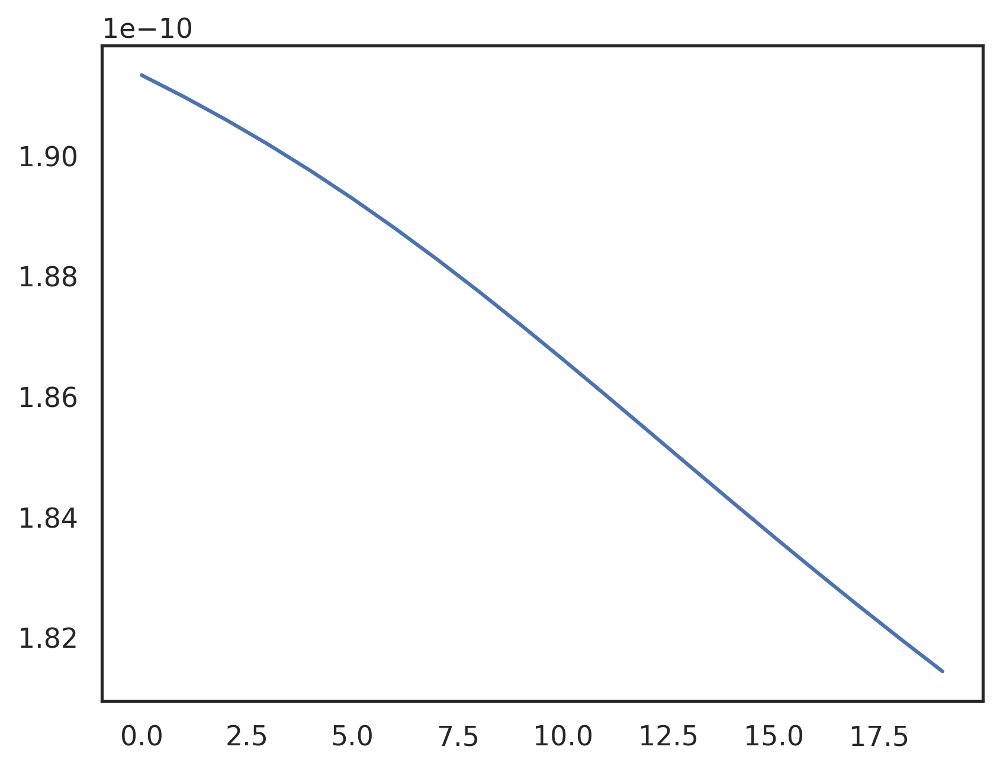

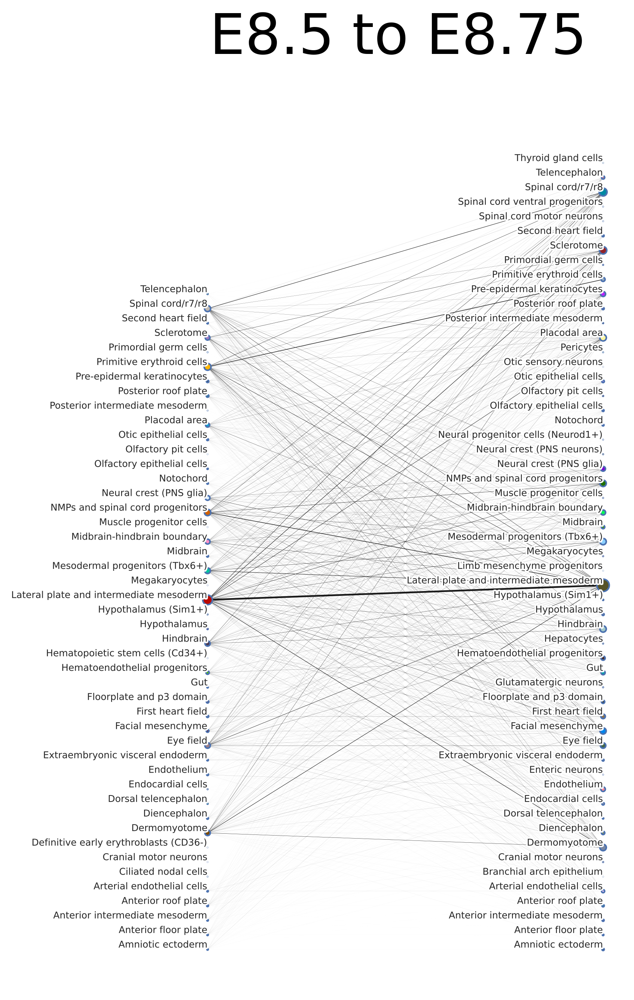

Mapping Amniotic ectoderm to self at times E8.5 to E8.75
Mapping Anterior floor plate to self at times E8.5 to E8.75
Mapping Anterior intermediate mesoderm to self at times E8.5 to E8.75
Mapping Anterior roof plate to self at times E8.5 to E8.75
Mapping Arterial endothelial cells to self at times E8.5 to E8.75
Mapping Cranial motor neurons to self at times E8.5 to E8.75
Mapping Dermomyotome to self at times E8.5 to E8.75
Mapping Diencephalon to self at times E8.5 to E8.75
Mapping Dorsal telencephalon to self at times E8.5 to E8.75
Mapping Endocardial cells to self at times E8.5 to E8.75
Mapping Endothelium to self at times E8.5 to E8.75
Mapping Extraembryonic visceral endoderm to self at times E8.5 to E8.75
Mapping Eye field to self at times E8.5 to E8.75
Mapping Facial mesenchyme to self at times E8.5 to E8.75
Mapping First heart field to self at times E8.5 to E8.75
Mapping Floorplate and p3 domain to self at times E8.5 to E8.75
Mapping Gut to self at times E8.5 to E8.75
Mapping Hemat

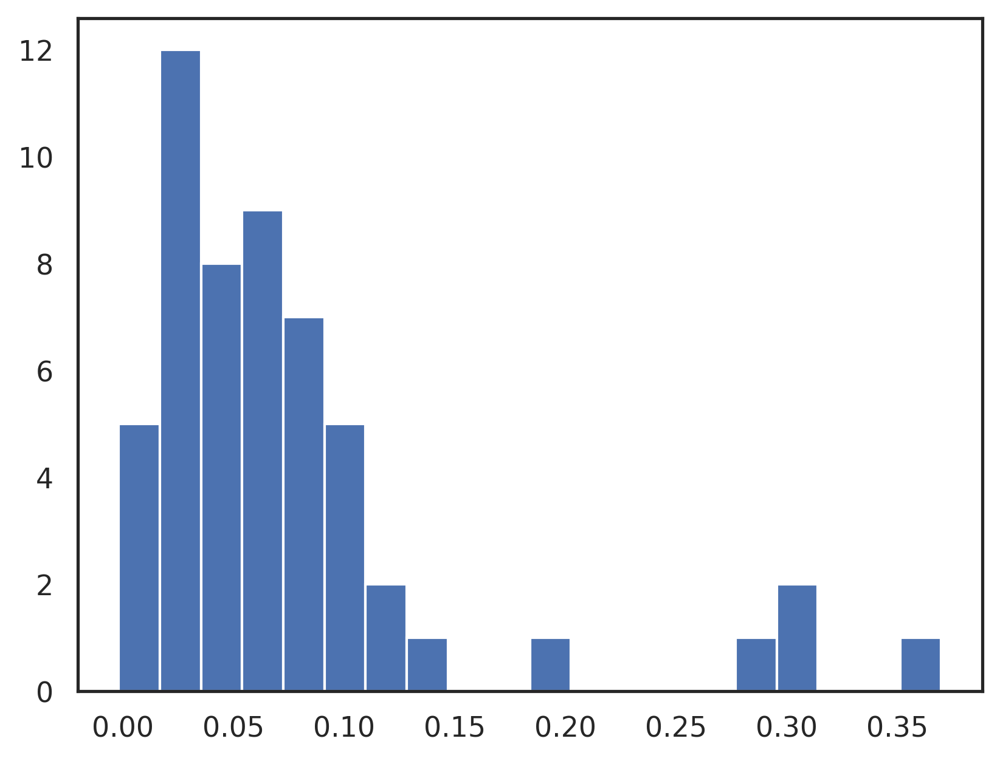

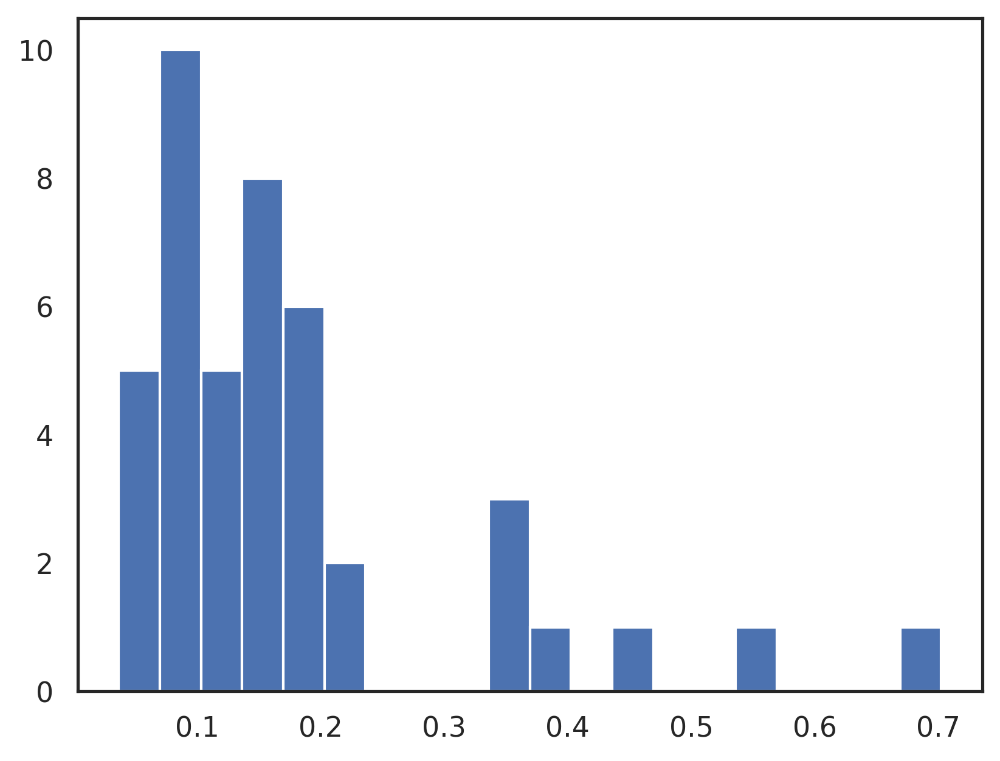

Mean NPMI (off-diagonal): 0.07682805508375168
Mean NPMI (diagonal): 0.17755712568759918
Computing low-rank distance matrix!
Iteration: 0
Initial Wasserstein cost: 1.8946007263043185e-10, GW-cost: 0, Total cost: 1.8946007263043185e-10
Final Wasserstein cost: 1.695083240438322e-10, GW-cost: 0, Total cost: 1.695083240438322e-10


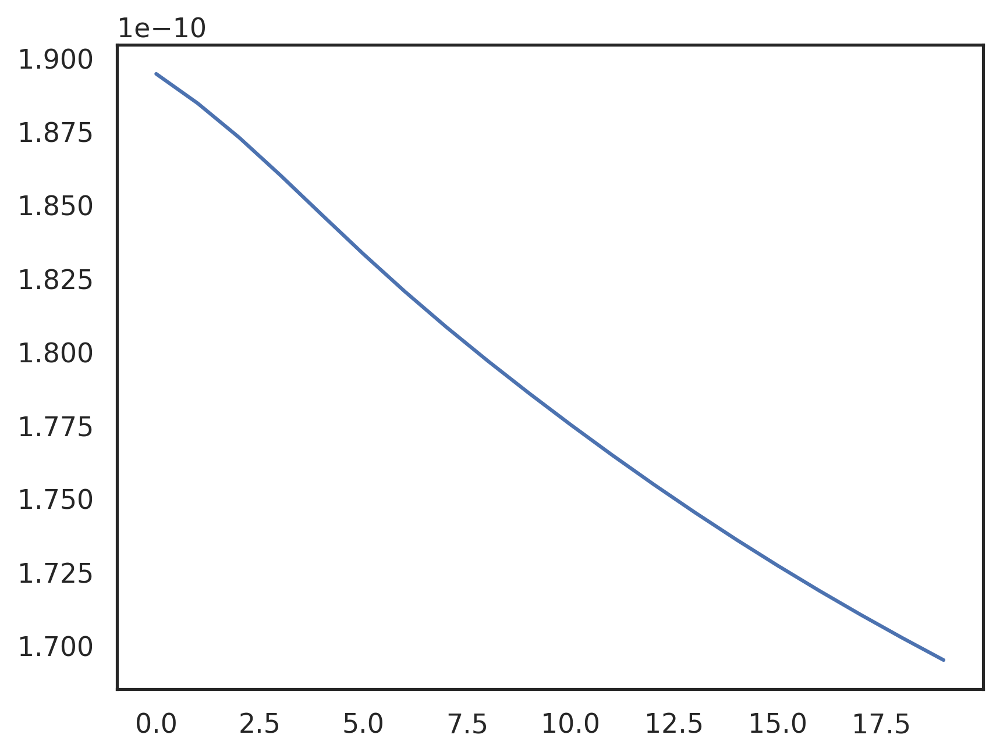

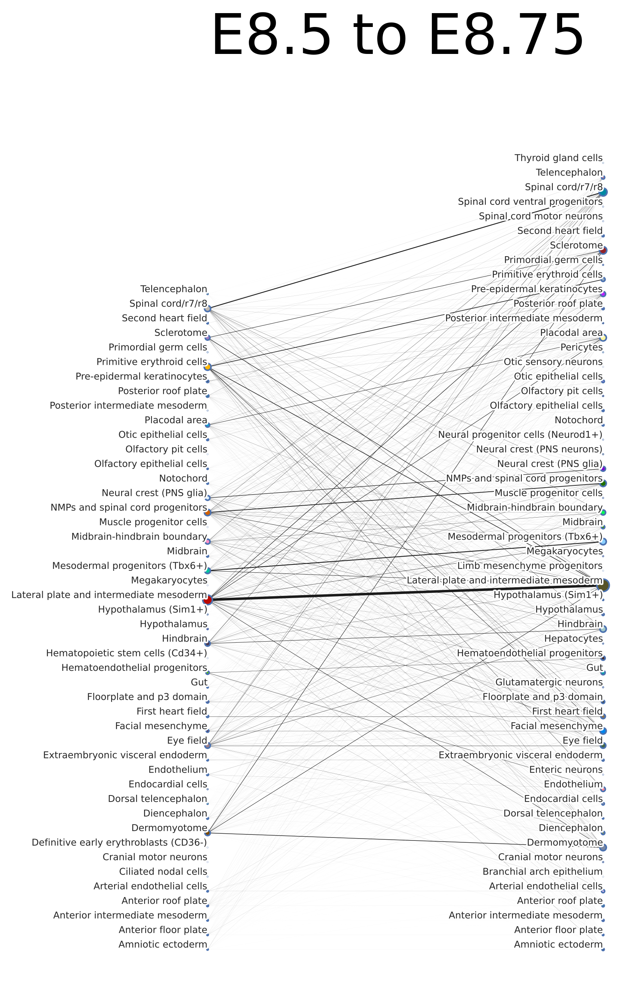

Mapping Amniotic ectoderm to self at times E8.5 to E8.75
Mapping Anterior floor plate to self at times E8.5 to E8.75
Mapping Anterior intermediate mesoderm to self at times E8.5 to E8.75
Mapping Anterior roof plate to self at times E8.5 to E8.75
Mapping Arterial endothelial cells to self at times E8.5 to E8.75
Mapping Cranial motor neurons to self at times E8.5 to E8.75
Mapping Dermomyotome to self at times E8.5 to E8.75
Mapping Diencephalon to self at times E8.5 to E8.75
Mapping Dorsal telencephalon to self at times E8.5 to E8.75
Mapping Endocardial cells to self at times E8.5 to E8.75
Mapping Endothelium to self at times E8.5 to E8.75
Mapping Extraembryonic visceral endoderm to self at times E8.5 to E8.75
Mapping Eye field to self at times E8.5 to E8.75
Mapping Facial mesenchyme to self at times E8.5 to E8.75
Mapping First heart field to self at times E8.5 to E8.75
Mapping Floorplate and p3 domain to self at times E8.5 to E8.75
Mapping Gut to self at times E8.5 to E8.75
Mapping Hemat

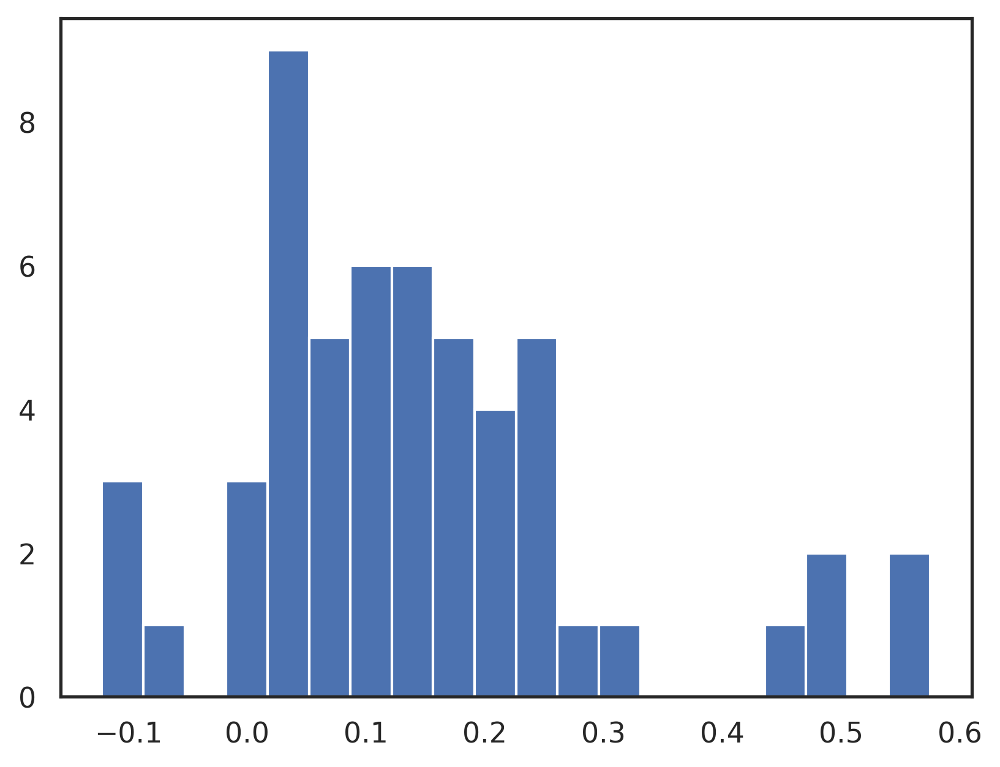

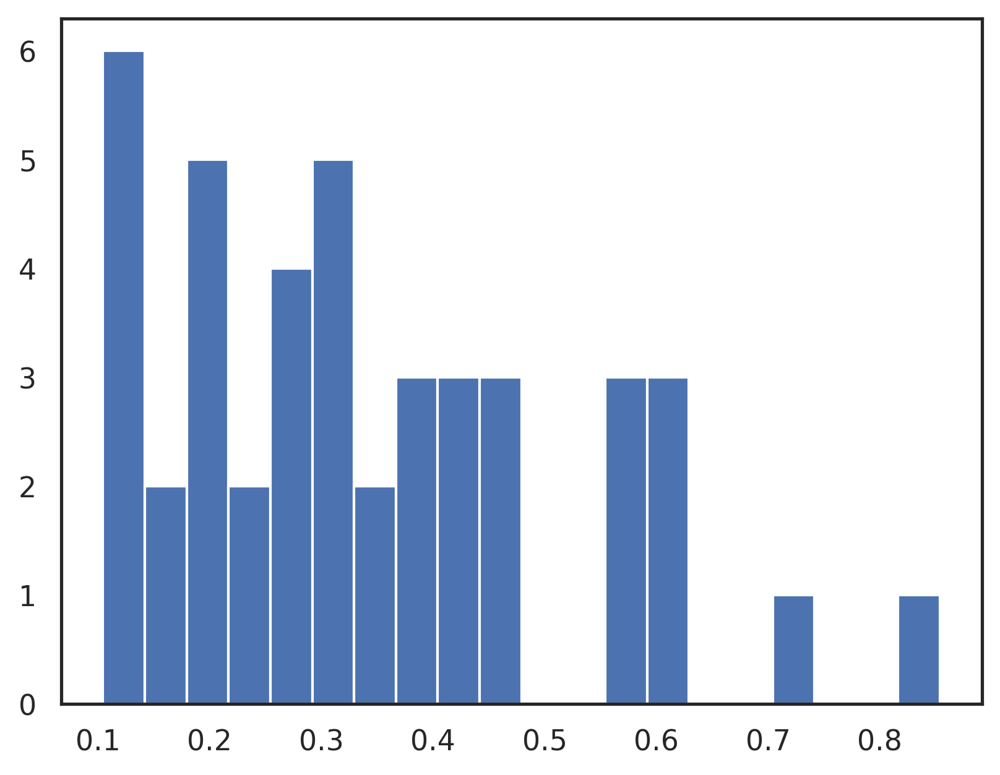

Mean NPMI (off-diagonal): 0.14322245121002197
Mean NPMI (diagonal): 0.3453982174396515
Computing low-rank distance matrix!
Iteration: 0
Initial Wasserstein cost: 1.8709900295732496e-10, GW-cost: 0, Total cost: 1.8709900295732496e-10
Final Wasserstein cost: 1.6333745467278504e-10, GW-cost: 0, Total cost: 1.6333745467278504e-10


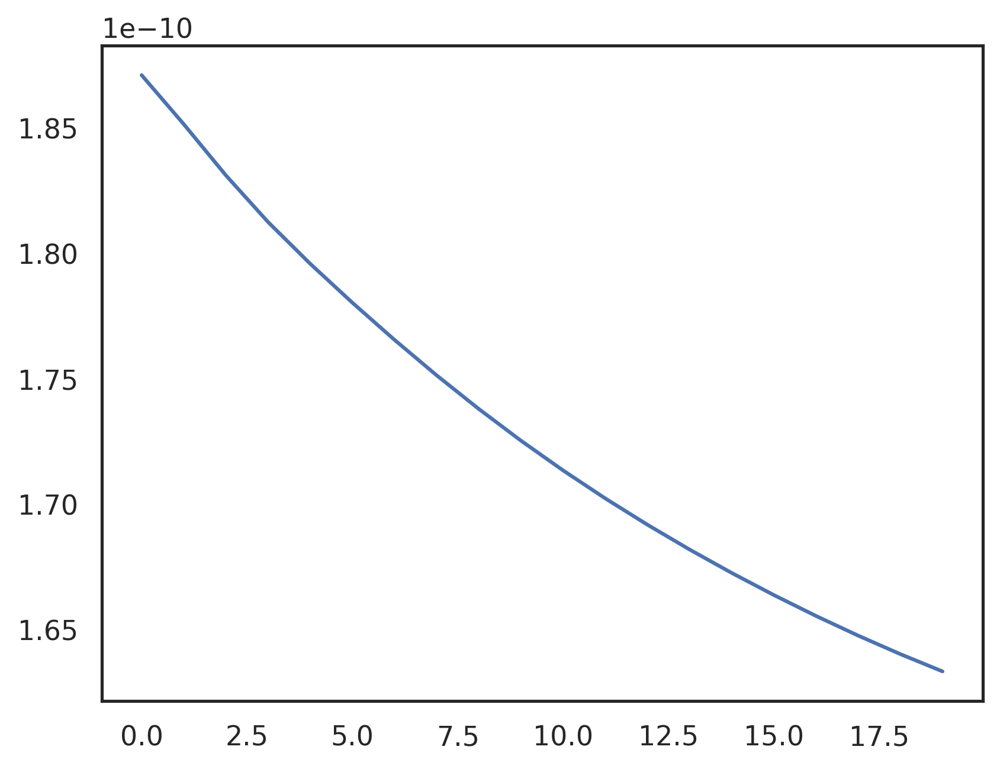

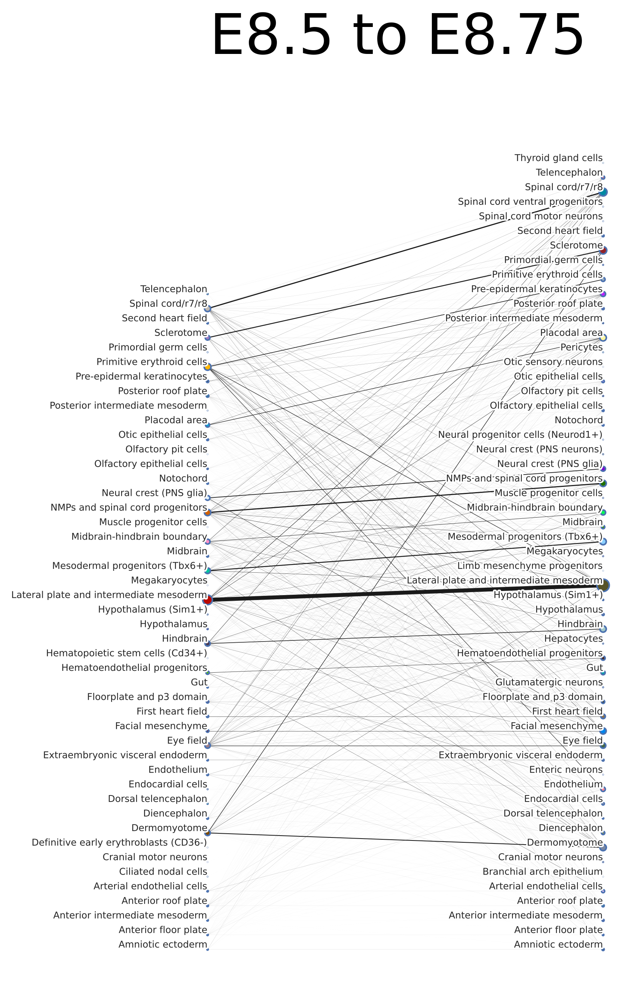

Mapping Amniotic ectoderm to self at times E8.5 to E8.75
Mapping Anterior floor plate to self at times E8.5 to E8.75
Mapping Anterior intermediate mesoderm to self at times E8.5 to E8.75
Mapping Anterior roof plate to self at times E8.5 to E8.75
Mapping Arterial endothelial cells to self at times E8.5 to E8.75
Mapping Cranial motor neurons to self at times E8.5 to E8.75
Mapping Dermomyotome to self at times E8.5 to E8.75
Mapping Diencephalon to self at times E8.5 to E8.75
Mapping Dorsal telencephalon to self at times E8.5 to E8.75
Mapping Endocardial cells to self at times E8.5 to E8.75
Mapping Endothelium to self at times E8.5 to E8.75
Mapping Extraembryonic visceral endoderm to self at times E8.5 to E8.75
Mapping Eye field to self at times E8.5 to E8.75
Mapping Facial mesenchyme to self at times E8.5 to E8.75
Mapping First heart field to self at times E8.5 to E8.75
Mapping Floorplate and p3 domain to self at times E8.5 to E8.75
Mapping Gut to self at times E8.5 to E8.75
Mapping Hemat

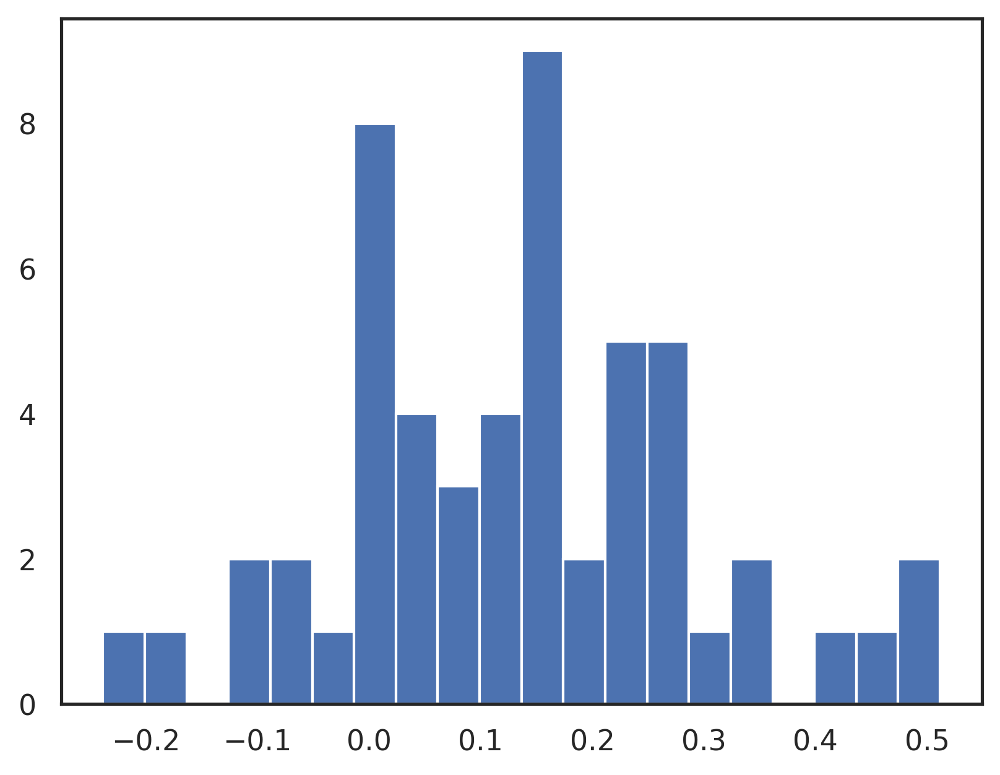

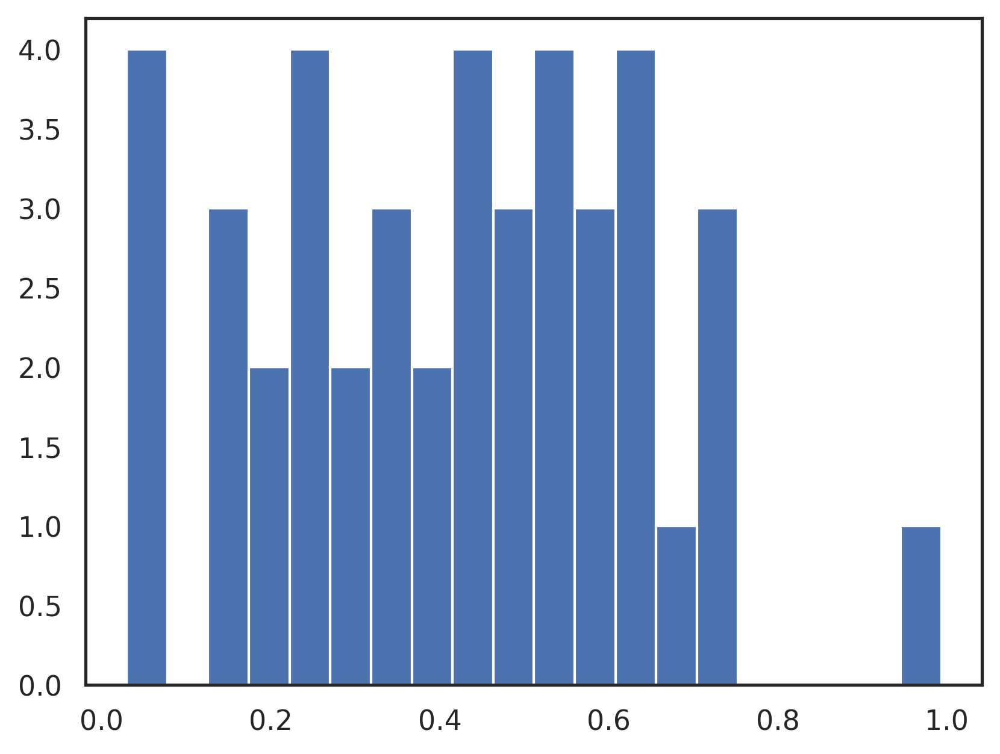

Mean NPMI (off-diagonal): 0.134269580245018
Mean NPMI (diagonal): 0.4162077307701111
Computing low-rank distance matrix!
Iteration: 0
Initial Wasserstein cost: 1.9016119234827045e-10, GW-cost: 0, Total cost: 1.9016119234827045e-10
Final Wasserstein cost: 1.632871060586183e-10, GW-cost: 0, Total cost: 1.632871060586183e-10


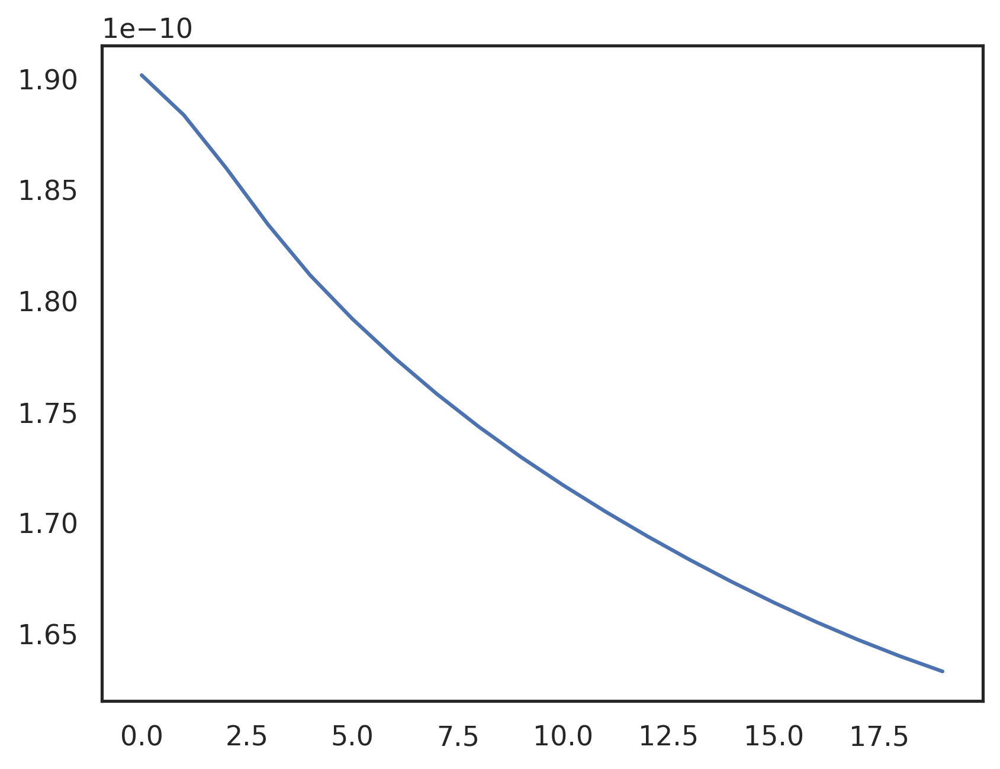

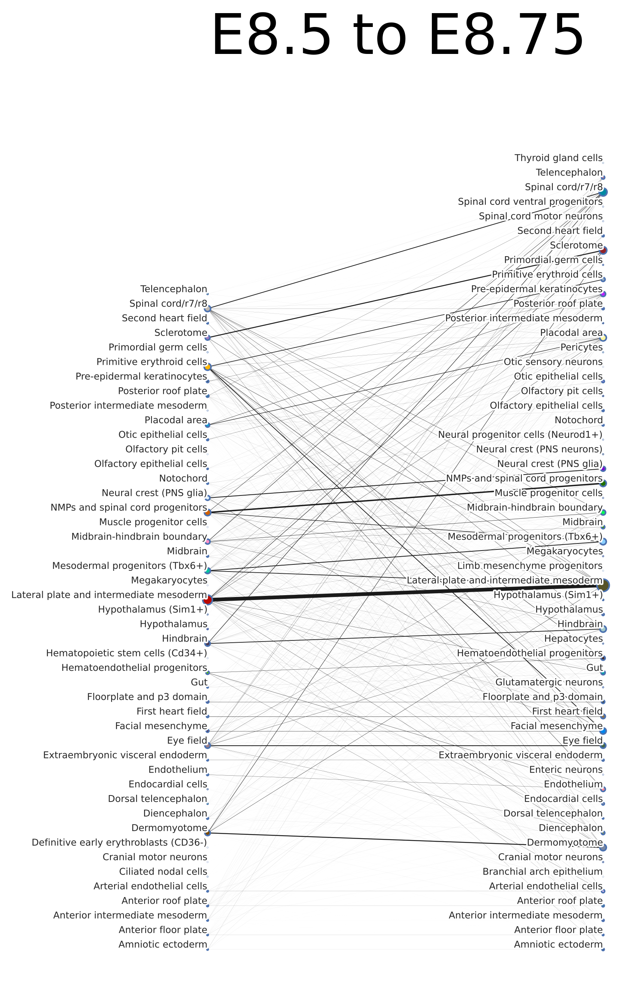

Mapping Amniotic ectoderm to self at times E8.5 to E8.75
Mapping Anterior floor plate to self at times E8.5 to E8.75
Mapping Anterior intermediate mesoderm to self at times E8.5 to E8.75
Mapping Anterior roof plate to self at times E8.5 to E8.75
Mapping Arterial endothelial cells to self at times E8.5 to E8.75
Mapping Cranial motor neurons to self at times E8.5 to E8.75
Mapping Dermomyotome to self at times E8.5 to E8.75
Mapping Diencephalon to self at times E8.5 to E8.75
Mapping Dorsal telencephalon to self at times E8.5 to E8.75
Mapping Endocardial cells to self at times E8.5 to E8.75
Mapping Endothelium to self at times E8.5 to E8.75
Mapping Extraembryonic visceral endoderm to self at times E8.5 to E8.75
Mapping Eye field to self at times E8.5 to E8.75
Mapping Facial mesenchyme to self at times E8.5 to E8.75
Mapping First heart field to self at times E8.5 to E8.75
Mapping Floorplate and p3 domain to self at times E8.5 to E8.75
Mapping Gut to self at times E8.5 to E8.75
Mapping Hemat

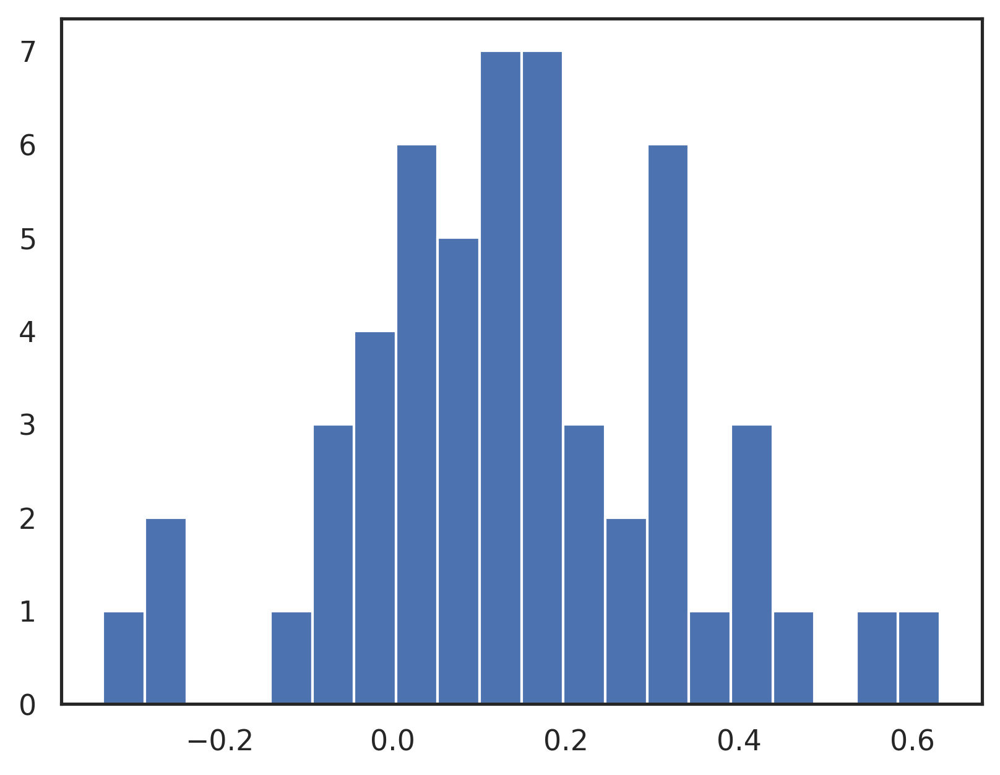

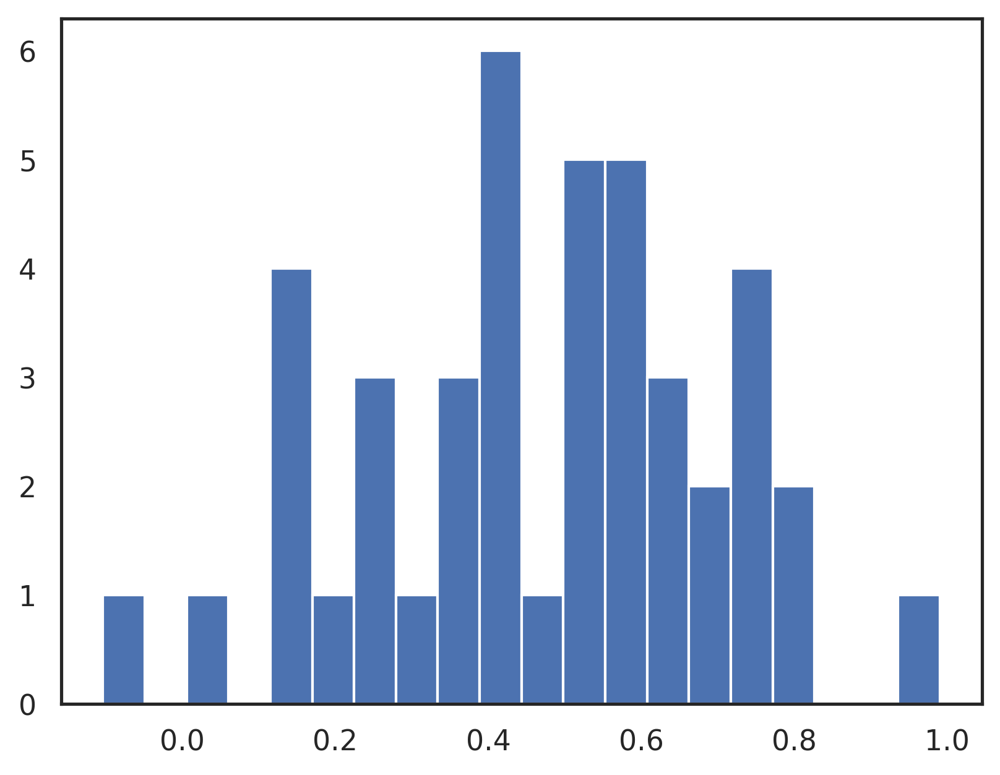

Mean NPMI (off-diagonal): 0.14107702672481537
Mean NPMI (diagonal): 0.4683590829372406
Computing low-rank distance matrix!
Iteration: 0
Initial Wasserstein cost: 1.895961998510387e-10, GW-cost: 0, Total cost: 1.895961998510387e-10
Final Wasserstein cost: 1.6240687961133204e-10, GW-cost: 0, Total cost: 1.6240687961133204e-10


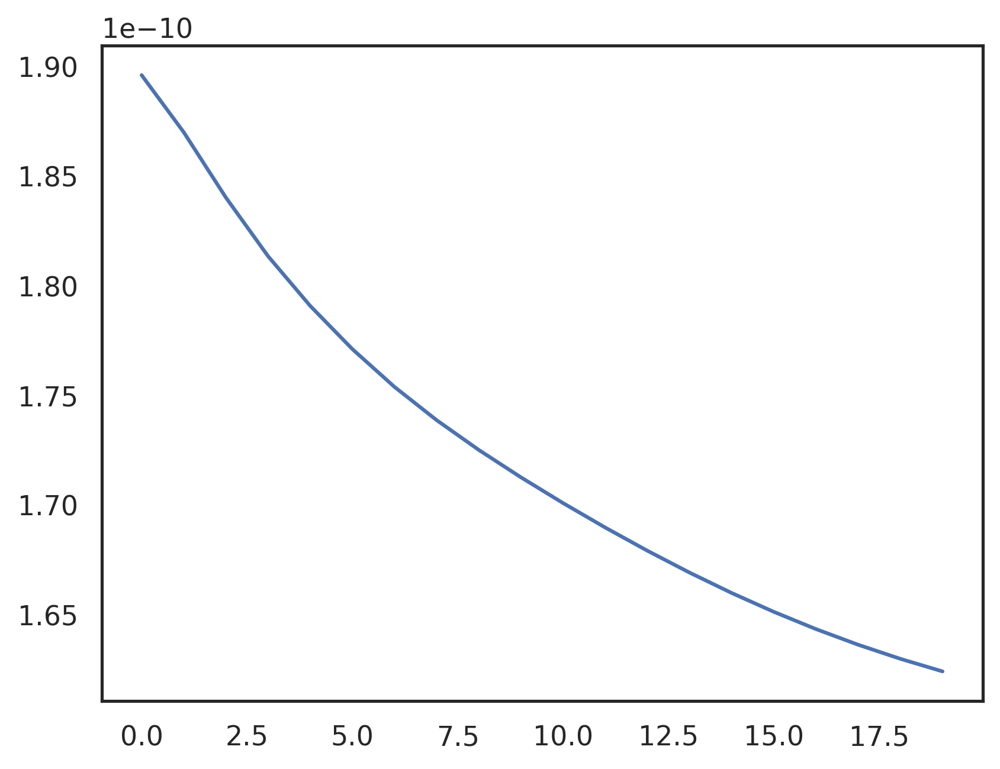

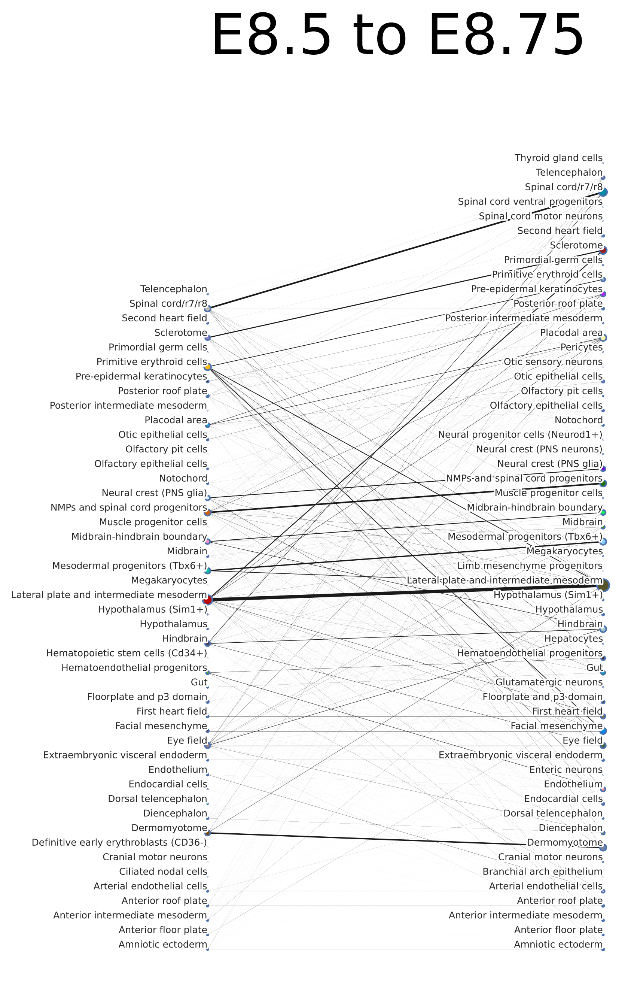

Mapping Amniotic ectoderm to self at times E8.5 to E8.75
Mapping Anterior floor plate to self at times E8.5 to E8.75
Mapping Anterior intermediate mesoderm to self at times E8.5 to E8.75
Mapping Anterior roof plate to self at times E8.5 to E8.75
Mapping Arterial endothelial cells to self at times E8.5 to E8.75
Mapping Cranial motor neurons to self at times E8.5 to E8.75
Mapping Dermomyotome to self at times E8.5 to E8.75
Mapping Diencephalon to self at times E8.5 to E8.75
Mapping Dorsal telencephalon to self at times E8.5 to E8.75
Mapping Endocardial cells to self at times E8.5 to E8.75
Mapping Endothelium to self at times E8.5 to E8.75
Mapping Extraembryonic visceral endoderm to self at times E8.5 to E8.75
Mapping Eye field to self at times E8.5 to E8.75
Mapping Facial mesenchyme to self at times E8.5 to E8.75
Mapping First heart field to self at times E8.5 to E8.75
Mapping Floorplate and p3 domain to self at times E8.5 to E8.75
Mapping Gut to self at times E8.5 to E8.75
Mapping Hemat

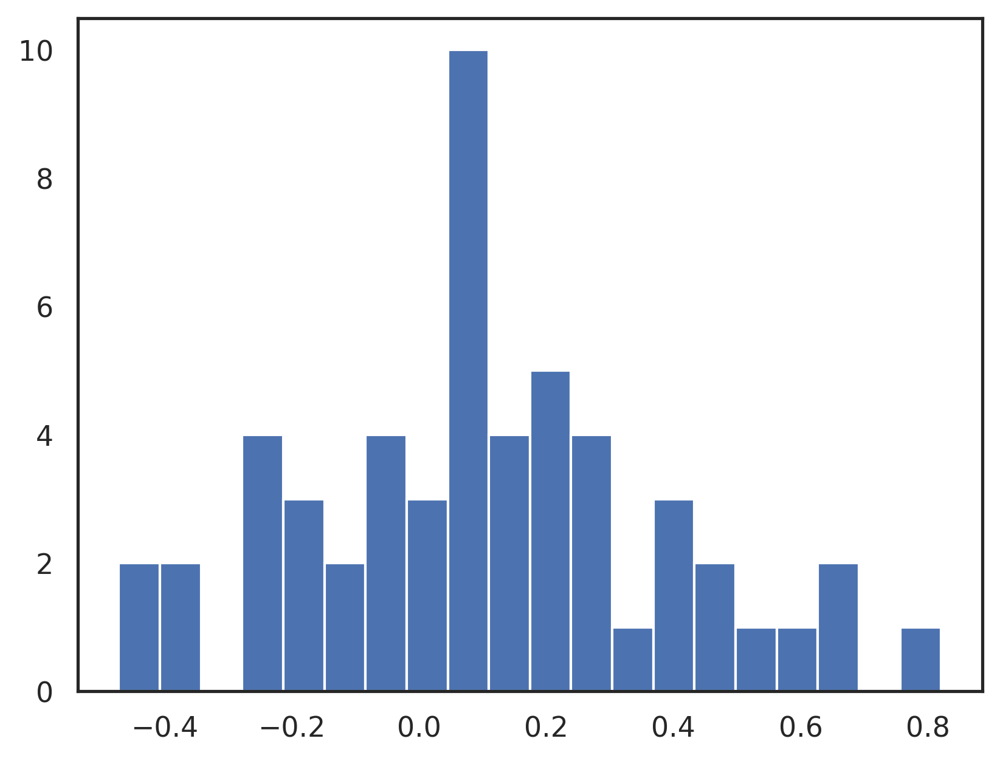

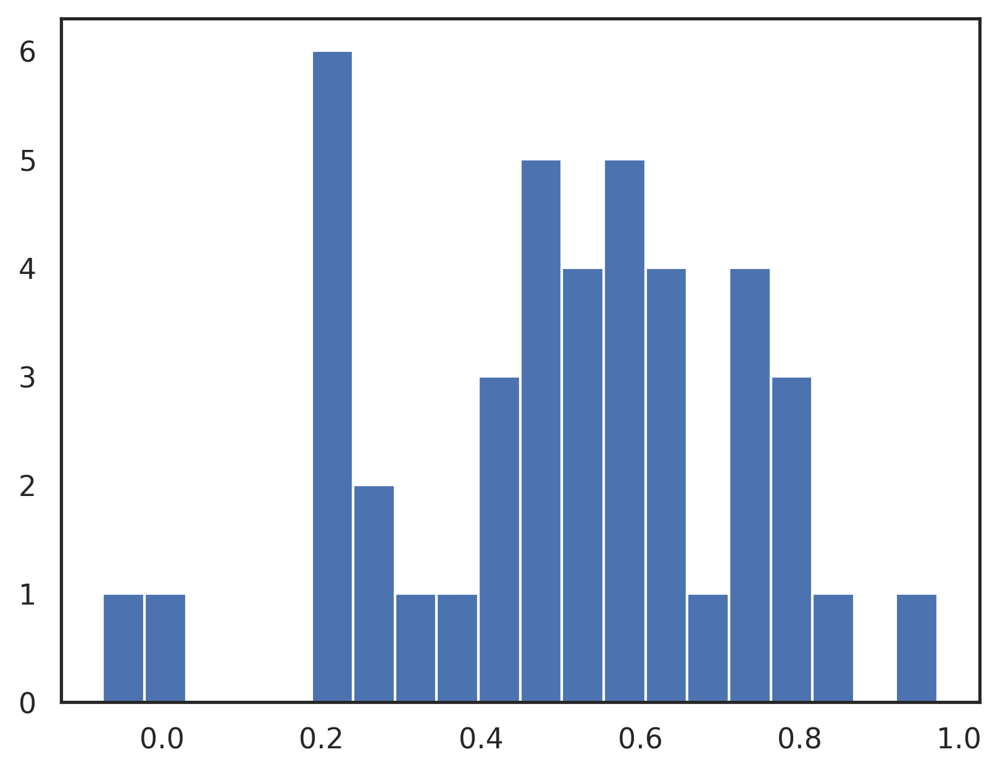

Mean NPMI (off-diagonal): 0.10350287705659866
Mean NPMI (diagonal): 0.49923980236053467
Computing low-rank distance matrix!
Iteration: 0
Initial Wasserstein cost: 1.8882893859650807e-10, GW-cost: 0, Total cost: 1.8882893859650807e-10
Final Wasserstein cost: 1.583078251821135e-10, GW-cost: 0, Total cost: 1.583078251821135e-10


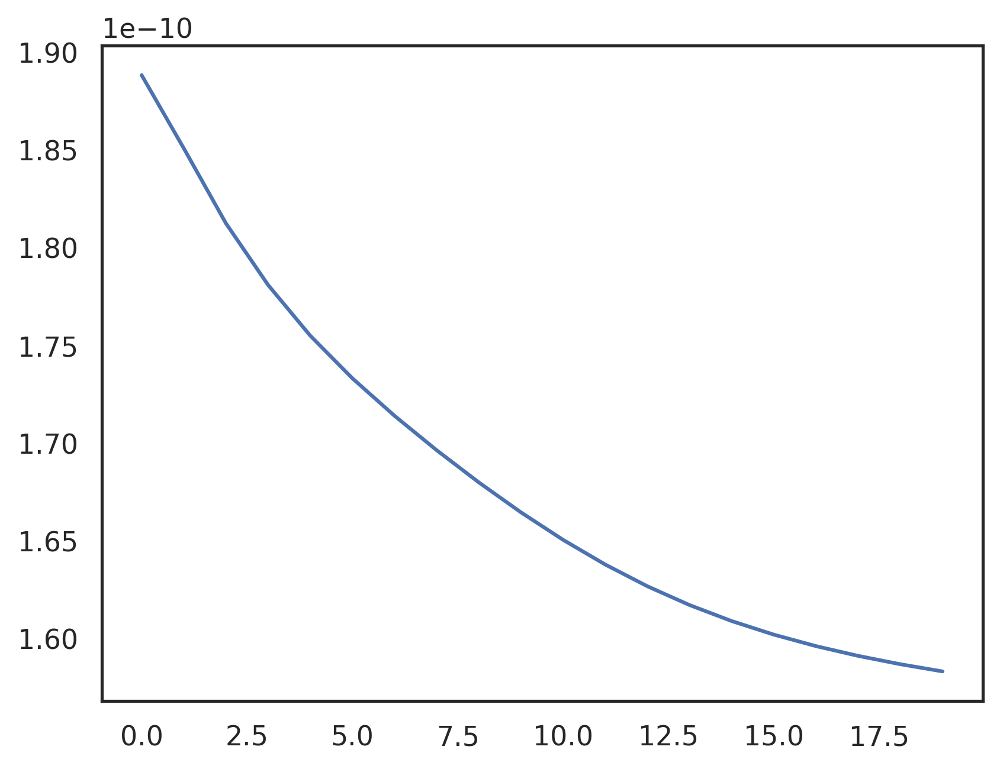

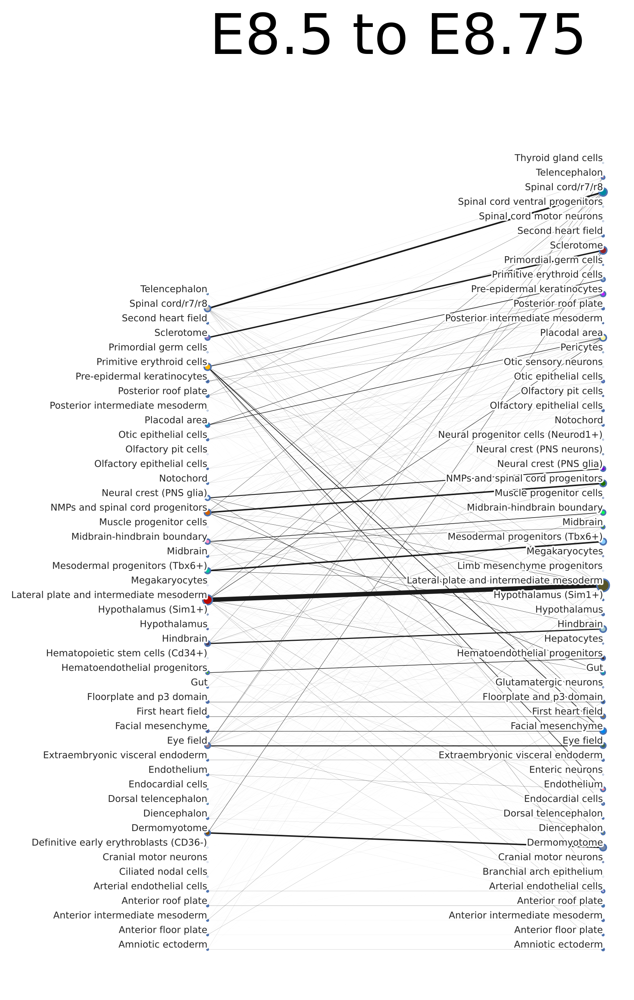

Mapping Amniotic ectoderm to self at times E8.5 to E8.75
Mapping Anterior floor plate to self at times E8.5 to E8.75
Mapping Anterior intermediate mesoderm to self at times E8.5 to E8.75
Mapping Anterior roof plate to self at times E8.5 to E8.75
Mapping Arterial endothelial cells to self at times E8.5 to E8.75
Mapping Cranial motor neurons to self at times E8.5 to E8.75
Mapping Dermomyotome to self at times E8.5 to E8.75
Mapping Diencephalon to self at times E8.5 to E8.75
Mapping Dorsal telencephalon to self at times E8.5 to E8.75
Mapping Endocardial cells to self at times E8.5 to E8.75
Mapping Endothelium to self at times E8.5 to E8.75
Mapping Extraembryonic visceral endoderm to self at times E8.5 to E8.75
Mapping Eye field to self at times E8.5 to E8.75
Mapping Facial mesenchyme to self at times E8.5 to E8.75
Mapping First heart field to self at times E8.5 to E8.75
Mapping Floorplate and p3 domain to self at times E8.5 to E8.75
Mapping Gut to self at times E8.5 to E8.75
Mapping Hemat

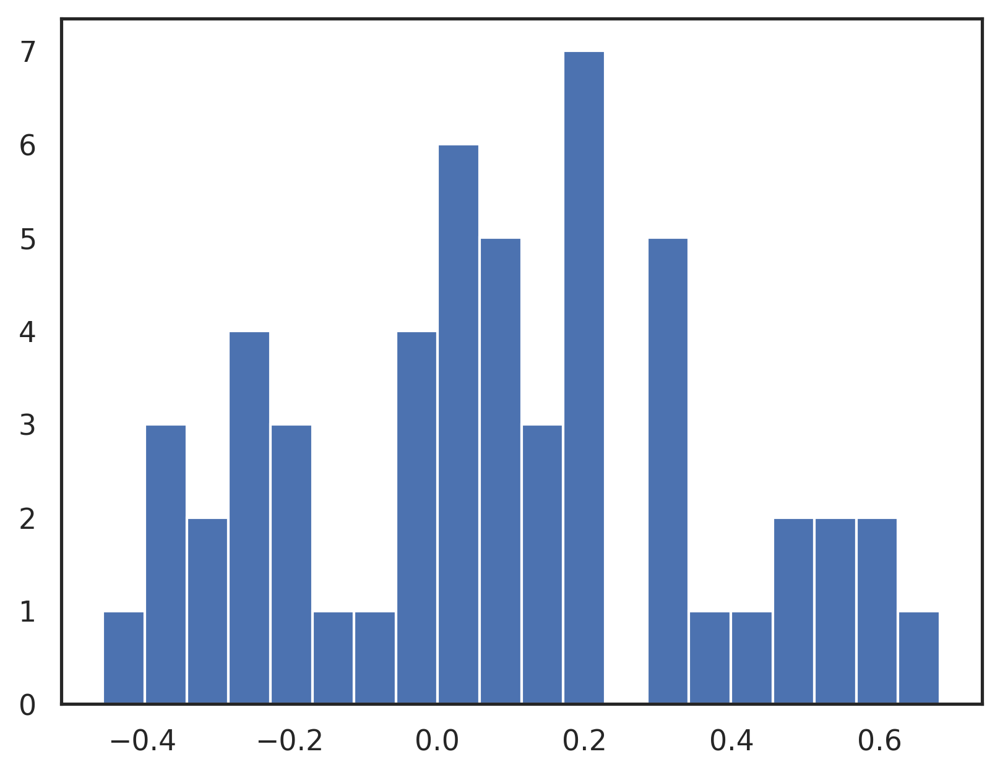

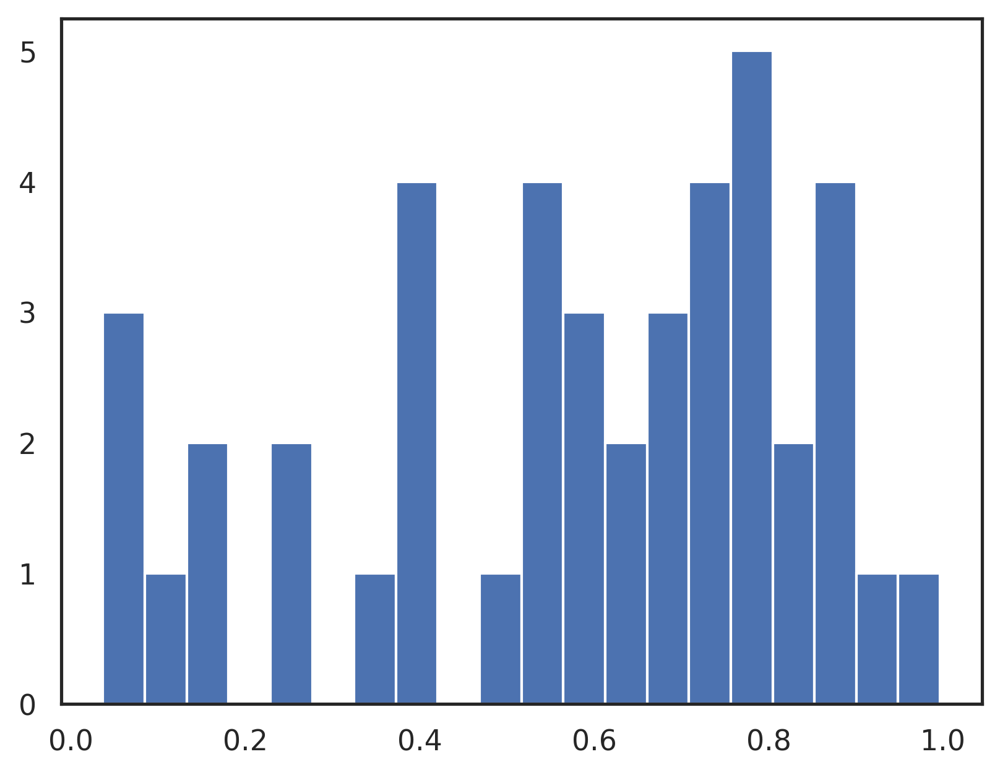

Mean NPMI (off-diagonal): 0.08530864119529724
Mean NPMI (diagonal): 0.5755736231803894
Computing low-rank distance matrix!
Iteration: 0
Initial Wasserstein cost: 1.848854125352517e-10, GW-cost: 0, Total cost: 1.848854125352517e-10
Final Wasserstein cost: 1.5489541593805e-10, GW-cost: 0, Total cost: 1.5489541593805e-10


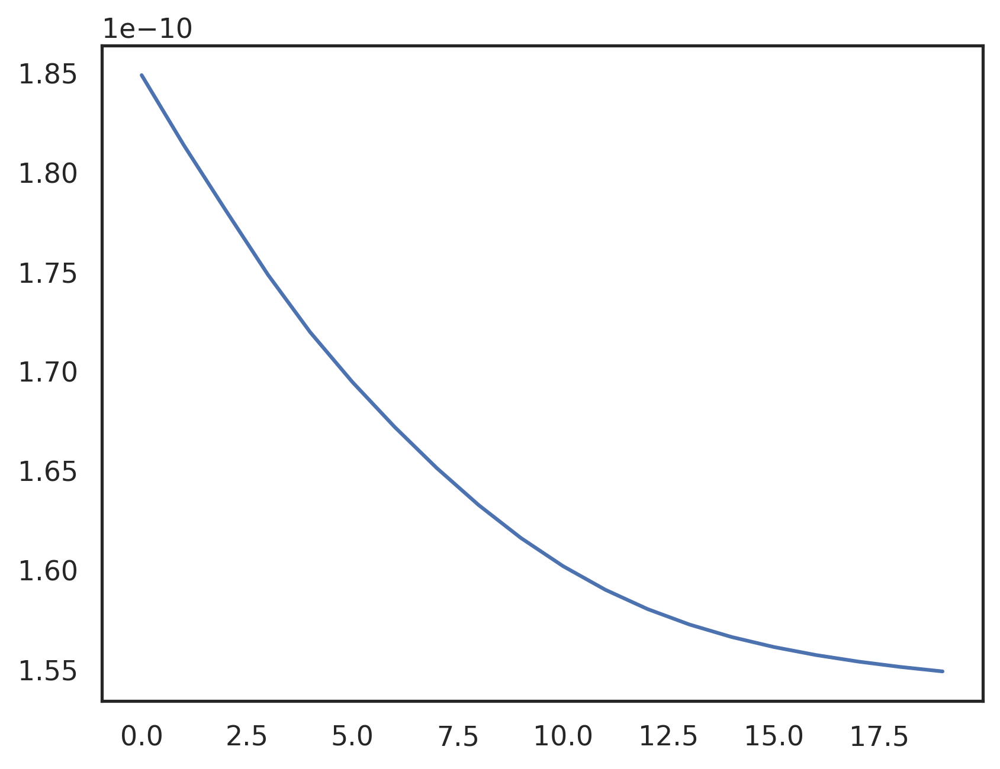

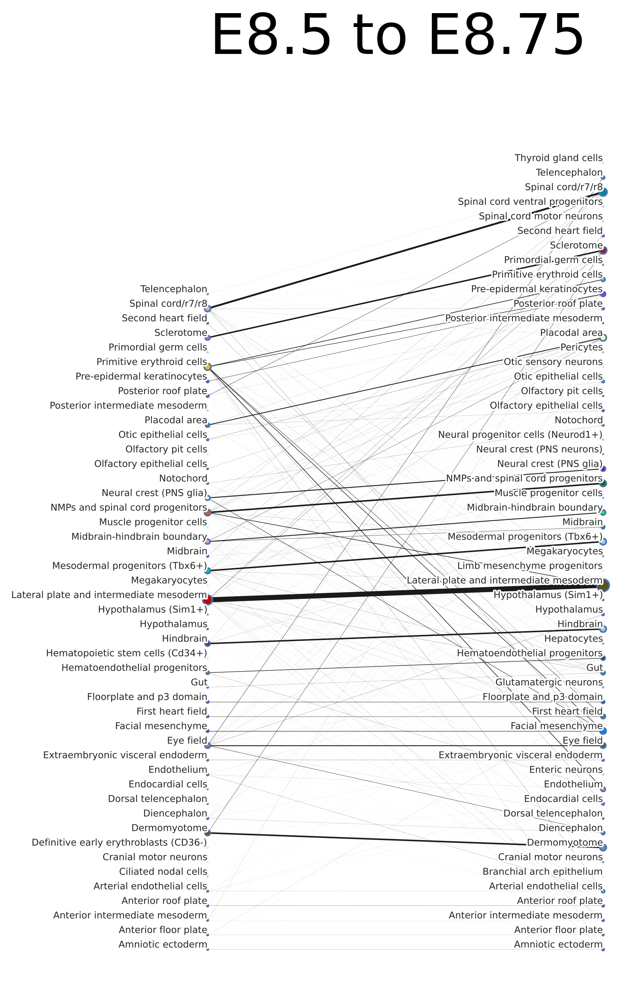

Mapping Amniotic ectoderm to self at times E8.5 to E8.75
Mapping Anterior floor plate to self at times E8.5 to E8.75
Mapping Anterior intermediate mesoderm to self at times E8.5 to E8.75
Mapping Anterior roof plate to self at times E8.5 to E8.75
Mapping Arterial endothelial cells to self at times E8.5 to E8.75
Mapping Cranial motor neurons to self at times E8.5 to E8.75
Mapping Dermomyotome to self at times E8.5 to E8.75
Mapping Diencephalon to self at times E8.5 to E8.75
Mapping Dorsal telencephalon to self at times E8.5 to E8.75
Mapping Endocardial cells to self at times E8.5 to E8.75
Mapping Endothelium to self at times E8.5 to E8.75
Mapping Extraembryonic visceral endoderm to self at times E8.5 to E8.75
Mapping Eye field to self at times E8.5 to E8.75
Mapping Facial mesenchyme to self at times E8.5 to E8.75
Mapping First heart field to self at times E8.5 to E8.75
Mapping Floorplate and p3 domain to self at times E8.5 to E8.75
Mapping Gut to self at times E8.5 to E8.75
Mapping Hemat

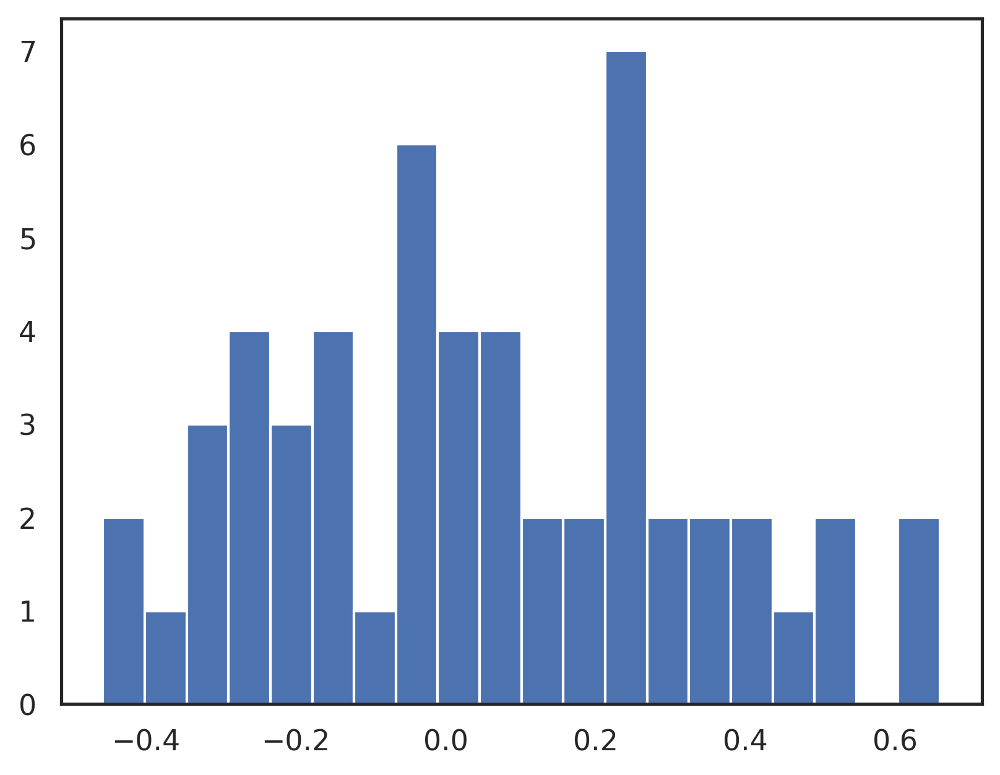

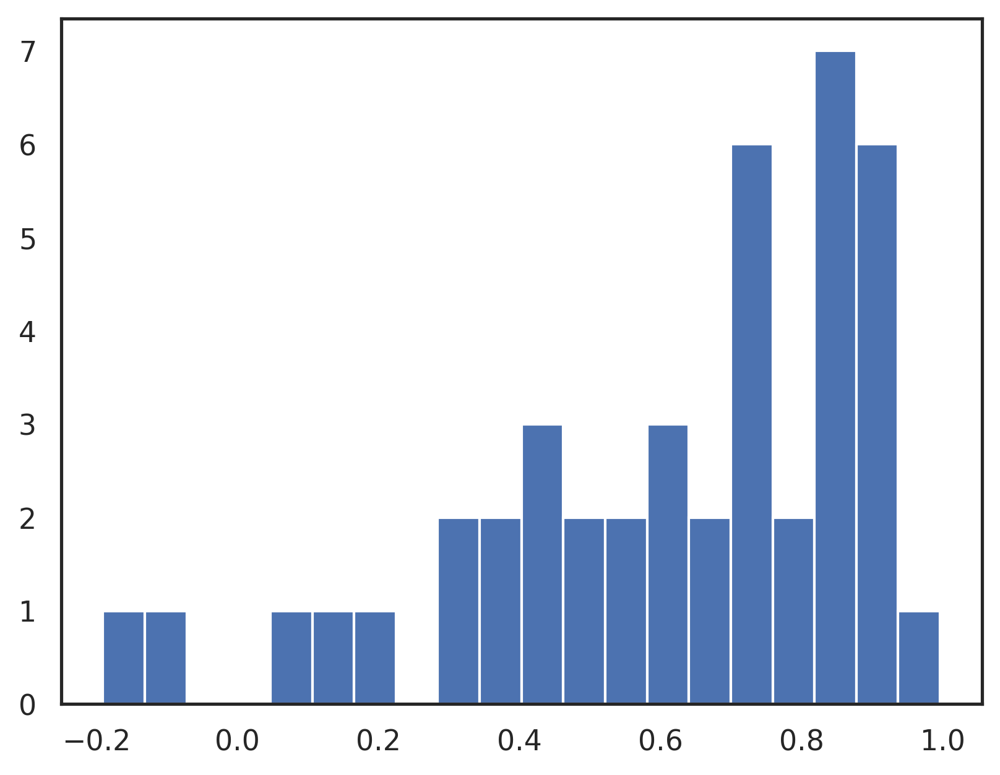

Mean NPMI (off-diagonal): 0.0551120825111866
Mean NPMI (diagonal): 0.6151001453399658
Computing low-rank distance matrix!
Iteration: 0
Initial Wasserstein cost: 1.8585269434545637e-10, GW-cost: 0, Total cost: 1.8585269434545637e-10
Final Wasserstein cost: 1.5898110605760962e-10, GW-cost: 0, Total cost: 1.5898110605760962e-10


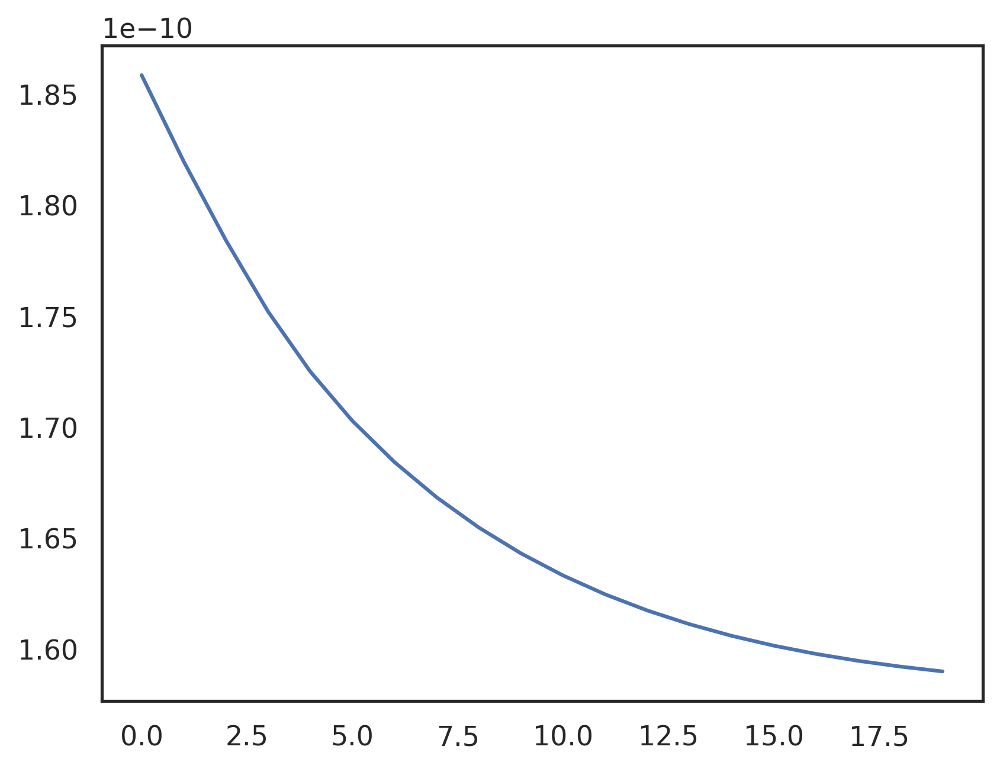

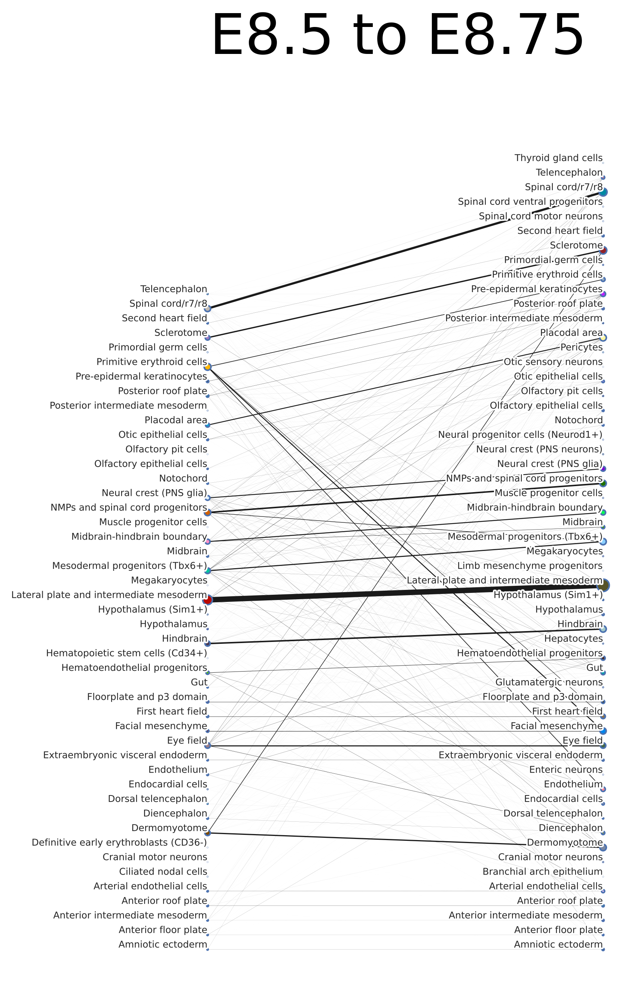

Mapping Amniotic ectoderm to self at times E8.5 to E8.75
Mapping Anterior floor plate to self at times E8.5 to E8.75
Mapping Anterior intermediate mesoderm to self at times E8.5 to E8.75
Mapping Anterior roof plate to self at times E8.5 to E8.75
Mapping Arterial endothelial cells to self at times E8.5 to E8.75
Mapping Cranial motor neurons to self at times E8.5 to E8.75
Mapping Dermomyotome to self at times E8.5 to E8.75
Mapping Diencephalon to self at times E8.5 to E8.75
Mapping Dorsal telencephalon to self at times E8.5 to E8.75
Mapping Endocardial cells to self at times E8.5 to E8.75
Mapping Endothelium to self at times E8.5 to E8.75
Mapping Extraembryonic visceral endoderm to self at times E8.5 to E8.75
Mapping Eye field to self at times E8.5 to E8.75
Mapping Facial mesenchyme to self at times E8.5 to E8.75
Mapping First heart field to self at times E8.5 to E8.75
Mapping Floorplate and p3 domain to self at times E8.5 to E8.75
Mapping Gut to self at times E8.5 to E8.75
Mapping Hemat

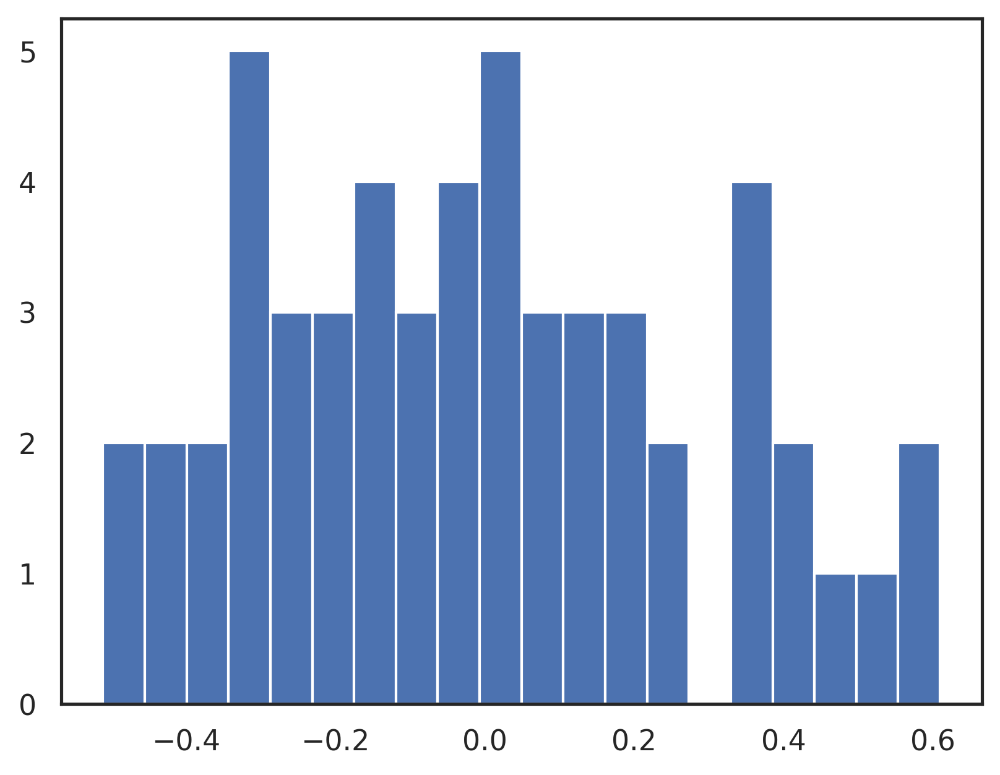

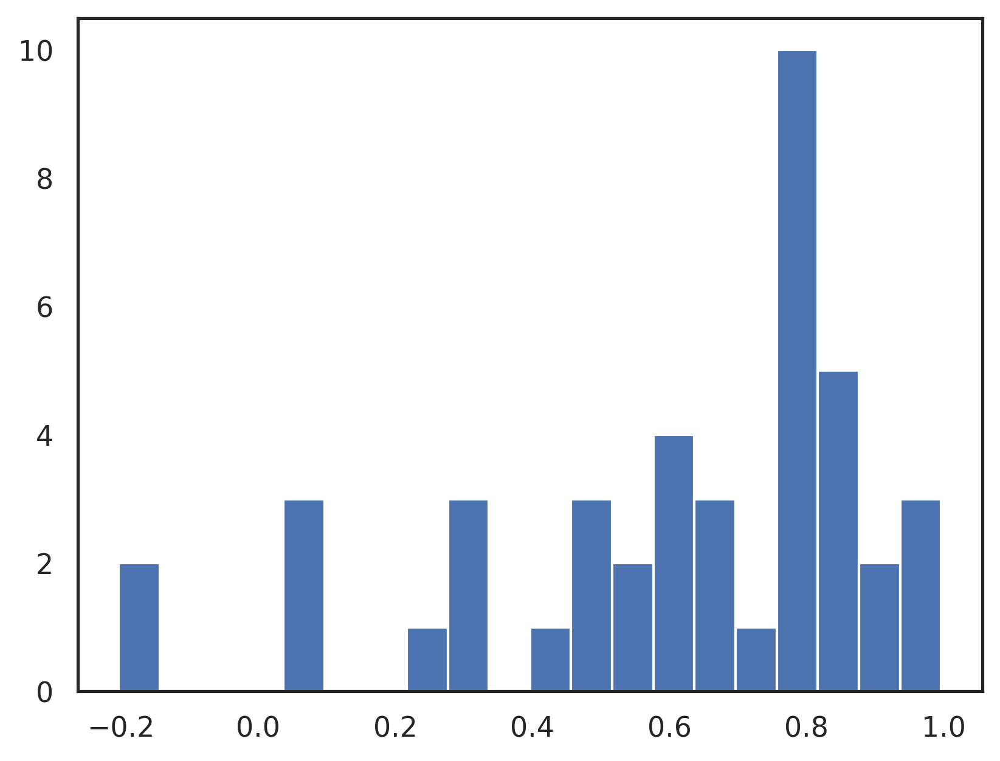

Mean NPMI (off-diagonal): -0.0039379820624554935
Mean NPMI (diagonal): 0.6030985116958618


In [22]:
import importlib
import differentiation_map_validation as dmv
importlib.reload(dmv)

gammas = [0.5, 1, 1.5, 2, 2.5, 3, 3.5, 4]
          #5, 10, 40, 100, 200]

mu_npmi = []
diag_mu_npmi = []


for gamma in gammas:
    
    C_factors_sequence, A_factors_sequence, Qs, labels, rank_list, _spatial_list = convert_adata(subset_adata, \
                                                                                  replicates=rps, \
                                                                                  timepoints=tps,
                                                                                    timepoint_key = 'day', 
                                                                                      replicate_key = 'embryo_id',
                                                                                      feature_key = 'X_pca',
                                                                                        cell_type_key = 'celltype_update',
                                                                                        spatial = False,
                                                                                        dist_eps = 0.03,
                                                                                        dist_rank = r_max, 
                                                                                        device = device)
    
    hmot = HiddenMarkovOT.HM_OT(rank_list, 
                                tau_in = 1e-5, 
                                tau_out = 5,
                                gamma=gamma, 
                                max_iter=20,
                                min_iter=20,
                                device=device,
                                dtype=torch.float32,
                                 printCost=True,
                                returnFull=False,
                                alpha=0.1,
                                initialization='Full')
    
    hmot.impute_annotated_transitions(C_factors_sequence, A_factors_sequence, Qs)
    
    Ts_ann = [T.cpu().numpy() for T in hmot.T_gammas]
    Qs_ann = [Q.cpu().numpy() for Q in Qs]
    
    plotting.diffmap_from_QT(Qs_ann, Ts_ann, labels, dsf=0.01, fontsize=6, linethick_factor=20, \
                             title= t1 + " to " + t2)
    
    edge_scores, diagonal_edge_scores = dmv.score_from_graph(Qs_ann, Ts_ann, labels, timepoints,
                             G, labels_G, edges_df, 
                            )
    
    npmis = []
    diagonal_npmis = []
    
    for key in edge_scores:
        # Assume at least one timepoint has transition, so apply max
        npmi_max = np.max(edge_scores[key])
        npmis.append(npmi_max)

    for key in diagonal_edge_scores:
        diagonal_npmi_mean = np.mean(diagonal_edge_scores[key])
        diagonal_npmis.append(diagonal_npmi_mean)
    
    plt.hist(npmis, bins=20)
    plt.show()

    plt.hist(diagonal_npmis, bins=20)
    plt.show()
    
    mu_npmi.append(np.mean(npmis))
    diag_mu_npmi.append(np.mean(diagonal_npmis))
    
    print(f'Mean NPMI (off-diagonal): {np.mean(npmis)}')
    print(f'Mean NPMI (diagonal): {np.mean(diagonal_npmis)}')


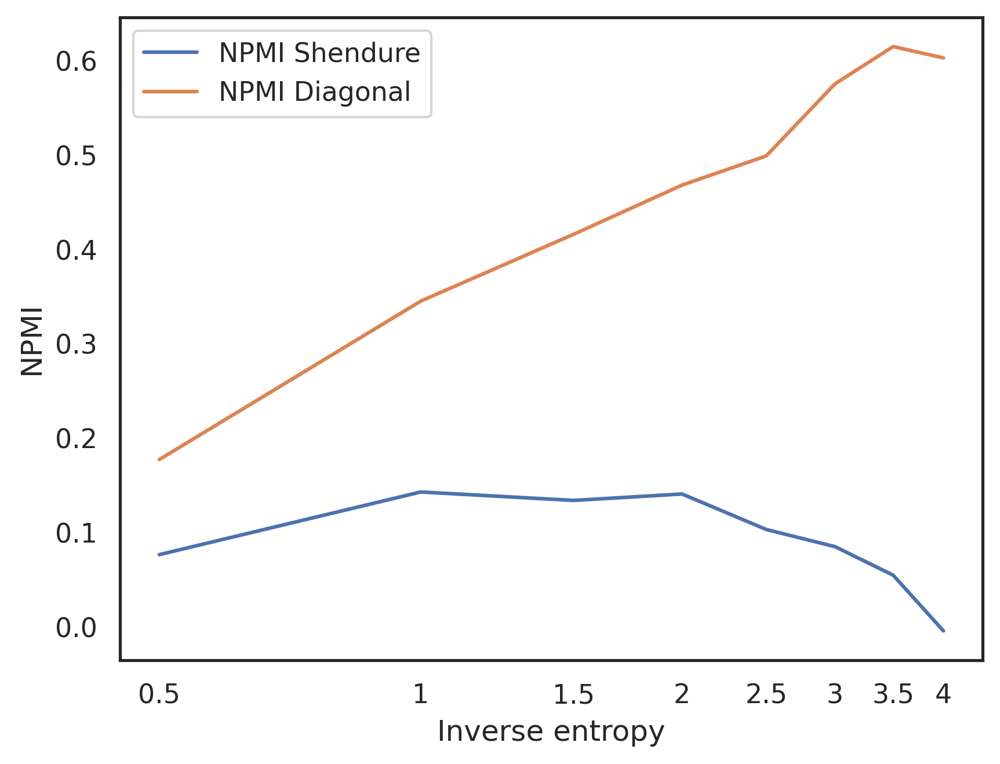

In [23]:
plt.plot(np.log(np.array(gammas)), mu_npmi, label='NPMI Shendure')
plt.plot(np.log(np.array(gammas)), diag_mu_npmi, label='NPMI Diagonal')
plt.xticks(np.log(np.array(gammas)), labels=[str(g) for g in gammas])
plt.xlabel('Inverse entropy')
plt.ylabel('NPMI')
plt.legend()
plt.show()

In [ ]:


npmis = []
npmis_all = []

# Diagonal transitions
for key in edge_scores_diagonal:
    
    print(f'Self-Transition: {key}')
    npmi_max = np.max(edge_scores_diagonal[key])
    npmis.append(npmi_max)
    
    npmis_all.extend(edge_scores_diagonal[key])
    print(f'max NPMI: {npmi_max}')

# Off-diagonal transitions
for key in edge_scores:
    
    print(f'Transition: {key}')
    npmi_max = np.max(edge_scores[key])
    npmis.append(npmi_max)
    
    npmis_all.extend(edge_scores[key])
    print(f'max NPMI: {npmi_max}')


# Set a high DPI and figure size
plt.figure(figsize=(10, 6), dpi=200)
plt.title("NPMI of Transitions from " + timepoints[0] + " to " + timepoints[-1] + " (max of an edge across timepoints)")
plt.ylabel("Frequency")
plt.xlabel("NPMI")
plt.grid(True, linestyle='--', alpha=0.5)
plt.hist(npmis, bins=50, color='skyblue', edgecolor='black')
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 6), dpi=200)
plt.title("NPMI of Transitions from " + timepoints[0] + " to " + timepoints[-1]  + " (edge score for every timepoint)")
plt.ylabel("Frequency")
plt.xlabel("NPMI")
plt.grid(True, linestyle='--', alpha=0.5)
plt.hist(npmis_all, bins=50, color='salmon', edgecolor='black')
plt.tight_layout()
plt.show()
